## Analyse Data Drift

In [52]:
# import des packages nécessaires :

import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder
import shap

from lightgbm import LGBMClassifier
from sklearn.preprocessing import MinMaxScaler
import re
import pickle
from sklearn.model_selection import train_test_split

import evidently
from evidently import ColumnMapping

from evidently.report import Report
from evidently.metrics.base_metric import generate_column_metrics
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset, DataQualityPreset, ClassificationPreset
from evidently.metrics import *

Pour la détection d'un éventuel datadrift nous utiliserons les jeux de données application_train et application_test sur lesquels nous appliquerons quelques traitements effectués lors de l'EDA.

In [2]:
# Import des jeu de données application train et test :
path = "F:/Utilisateur/Documents/Openclassrooms/Data Scientist/Formation/Projet 7 - Implémentez un modèle de scoring/Données projet/"
train_path = "application_train.csv"
test_path = "application_test.csv"

In [3]:
train_app = pd.read_csv(train_path)
test_app = pd.read_csv(test_path)

In [4]:
train_app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
test_app.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


### Fonctions EDA :

In [6]:
def get_test_set_ready(df):

    """Fonction qui applique les modifications/créations de features du train set

    Returns:
        DataFrame : le df d'entrée modifié
    """

    df["YEARS_BIRTH"] = - df["DAYS_BIRTH"]/365
    df["YEARS_EMPLOYED"]= - df["DAYS_EMPLOYED"]/365
    df.drop(["DAYS_BIRTH","DAYS_EMPLOYED"], axis=1, inplace=True)
    df["ANOM_YEARS_EMPLOYED"] = df["YEARS_EMPLOYED"] < -900
    df["YEARS_EMPLOYED"] = np.where(df["YEARS_EMPLOYED"]< -900, np.nan,df["YEARS_EMPLOYED"])
    df = df[df['CODE_GENDER']!= 'XNA']
    df["ORGANIZATION_TYPE"] = np.where(df["ORGANIZATION_TYPE"]=='XNA', np.nan, df["ORGANIZATION_TYPE"])

    df["INCOME_PER_PERSON"] = df["AMT_INCOME_TOTAL"] / df["CNT_FAM_MEMBERS"]
    df["ANNUITY_AS_INCOME_PERC"] = df["AMT_ANNUITY"] / df["AMT_INCOME_TOTAL"]
    df["PAYMENT_RATE"] = df["AMT_ANNUITY"] / df["AMT_CREDIT"]
    df["CREDIT_INCOME_RATIO"] = df["AMT_CREDIT"] / df["AMT_INCOME_TOTAL"]
    df["DOWN_PAYMENT"] = df["AMT_GOODS_PRICE"] - df["AMT_CREDIT"]
    df["EMPLOYMENT_AGE_RATIO"] =  df["YEARS_EMPLOYED"] / df["YEARS_BIRTH"]

    return df

In [7]:
# On crée une fonction car il nous faudra appliquer la même chose au test_df :

def delete_nan(df, seuil, col_to_keep = ['EXT_SOURCE_1', 'EXT_SOURCE_2','EXT_SOURCE_3']):
    """Fonction qui permet de supprimer les colonnes ayant un taux de valeurs manquantes supérieur à un seuil à fixer
    On choisit de conserver certaines des colonnes malgré tout pour notre analyse : col_to_keep
    
    df : Dataframe que l'on souhaite nettoyer,
    seuil : seuil de valeurs manquantes par colonnes au-delà duquel les colonnes seront supprimées,
    col_to_keep : exception, colonnes qu'on souhaite conserver
    
    retourne un dataframe nettoyé"""

    missing_values = df.isna().mean()
    list_delete = list(missing_values[missing_values > seuil].index)

    for col in col_to_keep:
        if col in list_delete:
            list_delete.remove(col)
    print(f"Suppression de {len(list_delete)} colonnes car elles contenaient trop de valeurs manquantes.")
    df.drop(list_delete, axis=1, inplace=True)

    return df, list_delete


In [8]:
# L'idée est d'encoder par Label Encoder les variables catégorielles ayant au maximum 2 modalités et d'encoder les autres par onehotencoder :

def cat_encoding(df):
    """Encodage des variables catégorielles : label encoder si nb modalités <=2, ohe sinon
    
    Args : df -> dataframe avec variables à encoder
    retourne un dataframe avec variables encodés"""

    label_enc = LabelEncoder()
    cat_col = list(df.select_dtypes('object').columns)
    le_col = [col for col in cat_col if df[col].nunique() <= 2]
    ohe_col = [col for col in cat_col if col not in le_col]

    # Transformation par Label Endoding :
    for col in le_col:
        label_enc.fit(df[col])
        df[col] = label_enc.transform(df[col])

    # Transformation par ohe via pd.get_dummies :
    df_enc = pd.get_dummies(df[ohe_col], dummy_na=True).astype('int')
    df_newcol = df.drop(ohe_col, axis = 1)
    df_newcol = df_newcol.join(df_enc)

    return df_newcol

In [9]:
def impute_nan(df):
    """Fonction d'imputation des données manquantes :
    - impute les variables numériques par leur médiane
    - impute les variables catégorielles par la modalité la plus fréquente
    
    Args : df -> dataframe où l'on souhaite imputer les valeurs manquantes
    """

    cat_var = list(df.select_dtypes('object').columns)
    num_var = [col for col in list(df.columns) if col not in cat_var]

    missing = df.isna().sum()
    list_feat = list(missing[missing>0].index)

    for feat in list_feat:
        if feat in cat_var:
            df[feat] = df[feat].fillna(df[feat].mode()[0])
        elif feat in num_var:
            df[feat] = df[feat].fillna(df[feat].median())
        else: print("Erreur")
    print(f"Vérification présence données manquantes après imputation :{df.isna().sum().sum()}")

In [10]:
train_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


### Analyse du datadrift entre les features du train set et celle du test set

La documentation Evidently recommande de réaliser un "ColumnMapping" : d'identifier les types de variables avant de réaliser un rapport.

In [11]:
categorical_features = ['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE']

In [12]:
numerical_features = [col for col in train_app.columns if col not in categorical_features and col != 'TARGET']

In [13]:
# On applique les fonctions de nettoyage sur le train set :

train_app = get_test_set_ready(train_app)
train_app, _ = delete_nan(train_app, 0.5)
impute_nan(train_app)
train_app = cat_encoding(train_app)

Suppression de 40 colonnes car elles contenaient trop de valeurs manquantes.
Vérification présence données manquantes après imputation :0


In [14]:
train_app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University,ORGANIZATION_TYPE_nan
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0,0,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0,0,0,0,0,0,0,0,0


In [15]:
# On applique les fonctions de nettoyage sur le test set :

test_app = get_test_set_ready(test_app)
test_app, _ = delete_nan(test_app, 0.5)
impute_nan(test_app)
test_app = cat_encoding(test_app)

Suppression de 29 colonnes car elles contenaient trop de valeurs manquantes.
Vérification présence données manquantes après imputation :0


In [16]:
test_app.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HOUSETYPE_MODE_terraced house,HOUSETYPE_MODE_nan,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,WALLSMATERIAL_MODE_nan
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0,0,0,1,0,0
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0,0,1,0,0,0
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0,0,1,0,0,0
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0,0,1,0,0,0
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,0,0,1,0,0,0


In [17]:
# Alignement des colonnes des deux jeux de données :
target = train_app["TARGET"] # on garde de coté la colonne target
train_app, test_app = train_app.align(test_app, join='inner', axis=1)

In [18]:
train_app["TARGET"] = target # on remet la target 
print(train_app.shape)
print(test_app.shape)

(307507, 201)
(48744, 200)


In [19]:
# on effectue le column mapping pour l'outil Evidently :

column_mapping = ColumnMapping()

column_mapping.target = None
column_mapping.prediction = None
column_mapping.id = 'SK_ID_CURR'
column_mapping.datetime = None
column_mapping.categorical_features = categorical_features
column_mapping.numerical_features = numerical_features

In [20]:
# On crée le rapport de drift de données :

data_drift_report = Report(metrics=[
    DataDriftPreset(),
])

In [21]:
# Création d'un dataset train sans la target pour le drift :
train_app_no_target = train_app.drop("TARGET", axis=1)

In [22]:
# Ici il s'agit de voir s'il y a un drift de données entre les variables présentes dans trainset et celles du test set :

data_drift_report.run(reference_data=train_app_no_target, current_data=test_app)
data_drift_report

f:\Utilisateur\Documents\Anaconda\Miniconda3\envs\api_env\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
f:\Utilisateur\Documents\Anaconda\Miniconda3\envs\api_env\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
f:\Utilisateur\Documents\Anaconda\Miniconda3\envs\api_env\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
f:\Utilisateur\Documents\Anaconda\Miniconda3\envs\api_env\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
f:\Utilisateur\Documents\Anaconda\Miniconda3\envs\api_env\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
f:\Utilisateur\Documents\Anaconda\Miniconda3\envs\api_env\lib\site-packages\nump

In [23]:
# On sauvegarde le rapport de drift de données :

data_drift_report.save_html('global_feature_drift_report.html')

### Analyse du datadrift sur les prédictions de notre modèle :

A priori on peut aussi analyser le drift des prédictions du modèles..

Pour cela je ne vais me servir que d'un échantillon (20000 individus) du jeu train ayant servi à la modélisation, que je vais séparer en 2 en utilisant sample pour avoir un jeu de données 'current' et un autre 'reference'.

On utilise notre explainer SHAP pour ne retenir que les features ayant le plus contribués à l'établissement des prédictions selon cet outil.

In [6]:
# Fonction qui charge des données :
def load_data(data_path):
    data = pd.read_csv(data_path)
    # On doit changer le nom des colonnes car LightLGBM ne supporte pas certains caractères :
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in data.columns}
    new_n_list = list(new_names.values())
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    data = data.rename(columns=new_names)
    data.set_index('SK_ID_CURR', inplace=True)
    return data

In [7]:
# Fonction qui charge le scaler et le modèle :
def load_scaler_model_explainer():
    with open(r"F:\Utilisateur\Documents\Openclassrooms\Data Scientist\Formation\Projet 7 - Implémentez un modèle de scoring\api_deploy\calibrated_lgbm_v2.pkl", 'rb') as f_in:
        model = pickle.load(f_in)
    with open(r"F:\Utilisateur\Documents\Openclassrooms\Data Scientist\Formation\Projet 7 - Implémentez un modèle de scoring\api_deploy\scaler_v2.pkl", 'rb') as f_in:
        scaler = pickle.load(f_in)
    with open(r"F:\Utilisateur\Documents\Openclassrooms\Data Scientist\Formation\Projet 7 - Implémentez un modèle de scoring\api_deploy\shap_explainer_v2.pkl", 'rb') as f_in:
        explainer = pickle.load(f_in)
    return scaler, model, explainer

In [8]:
def prepare_data(data, scaler):
    features = scaler.transform(data)
    features = pd.DataFrame(features, columns=data.columns, index=data.index)
    return features

In [9]:
# Je récupère le modèle, le scaler et l'explainer :
scaler, model, explainer = load_scaler_model_explainer()

In [10]:
train_set_path = r"F:\Utilisateur\Documents\Openclassrooms\Data Scientist\Formation\Projet 7 - Implémentez un modèle de scoring\Code_new\training.csv"
train_df = load_data(train_set_path)

In [11]:
# Je sélectionne un sous-échantillon des données pour des raisons d'allocation mémoire :
train_df = train_df.sample(20000, random_state=42)

In [12]:
train_df.head()

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,PREV_CASH_LOAN_PURPOSE_Moneyforathirdperson,PREV_CASH_LOAN_PURPOSE_Other,PREV_CASH_LOAN_PURPOSE_Paymentsonotherloans,PREV_CASH_LOAN_PURPOSE_Purchaseofelectronicequipment,PREV_CASH_LOAN_PURPOSE_Refusaltonamethegoal,PREV_CASH_LOAN_PURPOSE_Repairs,PREV_CASH_LOAN_PURPOSE_Urgentneeds,PREV_CASH_LOAN_PURPOSE_Weddinggiftholiday,PREV_CASH_LOAN_PURPOSE_XAP,TARGET
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
337756,0,1,1,1,1,225000.0,225000.0,24232.5,225000.0,0.015221,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
405321,0,0,0,0,0,221400.0,247500.0,9814.5,247500.0,0.015221,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
142233,0,1,0,0,0,360000.0,521136.0,54855.0,495000.0,0.046220,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
443286,1,0,0,0,1,675000.0,675000.0,33750.0,675000.0,0.032561,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
331778,0,0,1,1,0,103500.0,490495.5,27517.5,454500.0,0.008068,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0


In [13]:
# Je retire la TARGET pour la transformation des données :
target = train_df["TARGET"]
train_df = train_df.drop("TARGET", axis=1)

In [14]:
train_df_scaled = prepare_data(train_df, scaler)
train_df_scaled.head()

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,PREV_CASH_LOAN_PURPOSE_Medicine,PREV_CASH_LOAN_PURPOSE_Moneyforathirdperson,PREV_CASH_LOAN_PURPOSE_Other,PREV_CASH_LOAN_PURPOSE_Paymentsonotherloans,PREV_CASH_LOAN_PURPOSE_Purchaseofelectronicequipment,PREV_CASH_LOAN_PURPOSE_Refusaltonamethegoal,PREV_CASH_LOAN_PURPOSE_Repairs,PREV_CASH_LOAN_PURPOSE_Urgentneeds,PREV_CASH_LOAN_PURPOSE_Weddinggiftholiday,PREV_CASH_LOAN_PURPOSE_XAP
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
337756,0.0,1.0,1.0,1.0,0.052632,0.011091,0.044944,0.099778,0.044944,0.206749,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.019231
405321,0.0,0.0,0.0,0.0,0.000000,0.010890,0.050562,0.035129,0.050562,0.206749,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
142233,0.0,1.0,0.0,0.0,0.000000,0.018601,0.118885,0.237086,0.112360,0.635991,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.019231
443286,1.0,0.0,0.0,0.0,0.052632,0.036126,0.157303,0.142454,0.157303,0.446855,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
331778,0.0,0.0,1.0,1.0,0.000000,0.004331,0.111235,0.114508,0.102247,0.107702,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.019231


In [15]:
# Je fais des prédictions sur le jeu de données d'entrainement (seuil de 0.377 déterminé lors de la modélisation):
probs = model.predict_proba(train_df_scaled)[:, 1]
preds = (probs > 0.377).astype(int)

In [16]:
# Je récupère les SHAP values :
shap_values = explainer.shap_values(train_df_scaled)

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


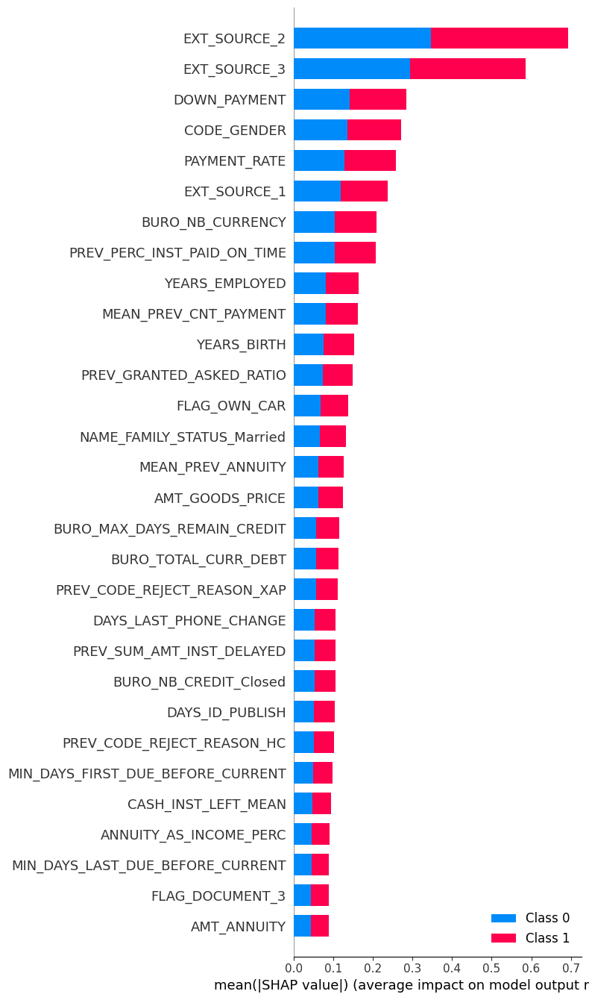

In [17]:
# Je crée un summary plot afin de voir les features les plus importantes :
shap.summary_plot(shap_values, train_df_scaled, plot_type="bar", max_display=30)

In [30]:
vals= np.abs(shap_values).mean(0)
feature_importance = pd.DataFrame(list(zip(train_df_scaled.columns, sum(vals))), columns=['col_name','feature_importance_vals'])
feature_importance.sort_values(by=['feature_importance_vals'], ascending=False,inplace=True)
feature_importance.head()

,col_name,feature_importance_vals
29,EXT_SOURCE_2,6923.224034
30,EXT_SOURCE_3,5867.755444
77,DOWN_PAYMENT,2844.578372
1,CODE_GENDER,2716.841434
75,PAYMENT_RATE,2578.837126
28,EXT_SOURCE_1,2379.948369
200,BURO_NB_CURRENCY,2092.086564
238,PREV_PERC_INST_PAID_ON_TIME,2083.938736
70,YEARS_EMPLOYED,1638.365395
233,MEAN_PREV_CNT_PAYMENT,1616.875140


In [34]:
most_imp_feat = feature_importance.head(30).col_name.values.tolist()

In [35]:
# je souhaite ne conserver que les features les plus importantes pour l'analyse :
train_df_scaled_drif = train_df_scaled[most_imp_feat]

In [36]:
train_df_scaled_drif.head()

,EXT_SOURCE_2,EXT_SOURCE_3,DOWN_PAYMENT,CODE_GENDER,PAYMENT_RATE,EXT_SOURCE_1,BURO_NB_CURRENCY,PREV_PERC_INST_PAID_ON_TIME,YEARS_EMPLOYED,MEAN_PREV_CNT_PAYMENT,...,PREV_SUM_AMT_INST_DELAYED,BURO_NB_CREDIT_Closed,DAYS_ID_PUBLISH,PREV_CODE_REJECT_REASON_HC,MIN_DAYS_FIRST_DUE_BEFORE_CURRENT,CASH_INST_LEFT_MEAN,ANNUITY_AS_INCOME_PERC,MIN_DAYS_LAST_DUE_BEFORE_CURRENT,FLAG_DOCUMENT_3,AMT_ANNUITY
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
337756,0.401060,0.820738,0.436364,1.0,0.836551,0.524440,0.333333,0.428571,0.354734,0.333333,...,0.006124,0.027778,0.406558,0.017241,0.001035,0.010386,0.055733,0.001505,1.0,0.099778
405321,0.686974,0.774562,0.436364,0.0,0.171744,0.563968,0.333333,0.000000,0.045221,0.000000,...,0.000000,0.074074,0.508962,0.000000,0.007850,0.000000,0.021892,0.007832,1.0,0.035129
142233,0.752788,0.598522,0.415244,1.0,0.812717,0.524440,0.000000,0.833333,0.071070,0.138889,...,0.003049,0.000000,0.651105,0.000000,0.005074,0.014838,0.079589,0.005789,0.0,0.237086
443286,0.922543,0.654165,0.436364,0.0,0.272820,0.524440,0.666667,0.000000,0.282548,0.000000,...,0.000000,0.055556,0.369598,0.000000,0.007850,0.000000,0.024920,0.007832,1.0,0.142454
331778,0.194769,0.626513,0.407276,0.0,0.332431,0.524440,0.333333,1.000000,0.092005,0.083333,...,0.000000,0.000000,0.395443,0.000000,0.006729,0.007631,0.140196,0.007117,0.0,0.114508


In [37]:
new_cat_var = ['CODE_GENDER', 'FLAG_OWN_CAR', 'NAME_FAMILY_STATUS_Married', 'PREV_CODE_REJECT_REASON_XAP', 'PREV_CODE_REJECT_REASON_HC', 'FLAG_DOCUMENT_3']
new_num_var = [col for col in train_df_scaled_drif.columns if col not in new_cat_var]

In [38]:
# J'ajoute les prédictions au jeu de données :
train_df_scaled_drif['prediction'] = preds

In [39]:
# J'ajoute la target pour l'analyse :
train_df_scaled_drif['TARGET'] = target

In [41]:
# Je crée un nouveau mapping pour le drift :
column_mapping_drift = ColumnMapping()
column_mapping_drift.target = 'TARGET'
column_mapping_drift.prediction = 'prediction'
column_mapping_drift.id = 'SK_ID_CURR'
column_mapping_drift.datetime = None
column_mapping_drift.categorical_features = new_cat_var
column_mapping_drift.numerical_features = new_num_var

In [43]:
new_data_drift_report = Report(metrics=[
    DataDriftPreset(),
])

In [42]:
reference = train_df_scaled_drif.sample(n=10000, replace=False)
current = train_df_scaled_drif.sample(n=10000, replace=False)

In [44]:
new_data_drift_report.run(reference_data=reference, current_data=current)
new_data_drift_report

In [45]:
# j'enregistre le rapport :
new_data_drift_report.save_html('most_important_features_drift_report.html')

### Analyse de Target Drift :

In [47]:
# Je crée un nouveau mapping pour le drift :
column_mapping_target_drift = ColumnMapping()
column_mapping_target_drift.target = 'TARGET'
column_mapping_target_drift.task = 'classification'
column_mapping_target_drift.prediction = 'prediction'
column_mapping_target_drift.id = 'SK_ID_CURR'
column_mapping_target_drift.datetime = None
column_mapping_target_drift.categorical_features = new_cat_var
column_mapping_target_drift.numerical_features = new_num_var

In [48]:
target_drift_report = Report(metrics=[
    TargetDriftPreset(),
])

In [49]:
reference = train_df_scaled_drif.sample(n=10000, replace=False)
current = train_df_scaled_drif.sample(n=10000, replace=False)

In [50]:
target_drift_report.run(reference_data=reference, current_data=current)
target_drift_report

In [51]:
# j'enregistre le rapport :
target_drift_report.save_html('target_drift_report.html')

### Analyse du datadrift de notre modèle de classification :

In [59]:
# Je crée un nouveau mapping pour le drift :
column_mapping_classification_drift = ColumnMapping()
column_mapping_classification_drift.target = 'target'
column_mapping_classification_drift.task = 'classification'
column_mapping_classification_drift.target_names = ['no_risk', 'risk']
column_mapping_classification_drift.prediction = 'prediction'
column_mapping_classification_drift.id = 'SK_ID_CURR'
column_mapping_classification_drift.datetime = None
column_mapping_classification_drift.categorical_features = new_cat_var
column_mapping_classification_drift.numerical_features = new_num_var

In [60]:
classification_drift_report = Report(metrics=[
    ClassificationPreset(),
])

In [61]:
reference = train_df_scaled_drif.sample(n=10000, replace=False)
current = train_df_scaled_drif.sample(n=10000, replace=False)

In [62]:
# Suite à une erreur je tente de passer en minuscule TARGET :
reference['target'] = reference['TARGET']
current['target'] = current['TARGET']

In [63]:
classification_drift_report.run(reference_data=reference, current_data=current)
classification_drift_report

In [64]:
# j'enregistre le rapport :
classification_drift_report.save_html('classification_drift_report.html')